# Visualization of Airbnb London dataset

## Analyzing the Prices and guest review scores of Airbnb listings along with their relationships accross all neighbourhoods in London

## Siddhant Kulkarni
## sk10841

We have the following datasets downloaded from the InsideAirbnb website (https://insideairbnb.com/get-the-data/):

1. Detailed Listings data for London: listings.csv

2. Detailed Review Data for listings in London: reviews.csv

3. Summary information and metrics for listings in London: listings_summary.csv

4. Summary Review data and Listing ID: reviews_summary.csv

5. Neighbourhood list of the city: neighbourhoods.csv

6. GeoJSON file of neighbourhoods of the city: neighbourhoods.geojson

# Importing libraries

In [1]:
pip install --upgrade altair

Note: you may need to restart the kernel to use updated packages.


In [2]:
import numpy as np 
import pandas as pd
import geopandas as gpd

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
import altair as alt
import json

import warnings
warnings.filterwarnings('ignore')

In [3]:
sns.set_style('white')

alt.theme.enable('default')
alt.renderers.set_embed_options(actions=False)
alt.data_transformers.enable('json')

DataTransformerRegistry.enable('json')

# Loading the dataset

In [4]:
listings_df = pd.read_csv('listings_summary.csv', parse_dates=['last_review'])

listings_detail_df = pd.read_csv('listings.csv', low_memory=False,parse_dates=['host_since', 'last_scraped', 'calendar_last_scraped',
                                              'first_review', 'last_review'])

reviews_df = pd.read_csv('reviews_summary.csv', parse_dates=['date'])

reviews_detail_df = pd.read_csv('reviews.csv', parse_dates=['date'])

neighbourhoods_df = pd.read_csv('neighbourhoods.csv')
gdf = gpd.read_file('neighbourhoods.geojson')

In [34]:
print("Shape of listings_df: ", listings_df.shape)
print("Shape of listings_detail_df: ", listings_detail_df.shape)
print("Shape of reviews_df: ", reviews_df.shape)
print("Shape of reviews_detail_df: ", reviews_detail_df.shape)
print("Shape of neighbourhoods_df: ", neighbourhoods_df.shape)

Shape of listings_df:  (85068, 16)
Shape of listings_detail_df:  (85068, 106)
Shape of reviews_df:  (1486236, 2)
Shape of reviews_detail_df:  (1486236, 6)
Shape of neighbourhoods_df:  (33, 2)


# Understanding the data

In [6]:
listings_df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,11551,Arty and Bright London Apartment in Zone 2,43039,Adriano,NaN,Lambeth,51.46225,-0.11732,Entire home/apt,88,3,185,2019-09-15,1.58,2,336
1,13913,Holiday London DB Room Let-on going,54730,Alina,NaN,Islington,51.56802,-0.11121,Private room,65,1,19,2019-10-07,0.17,2,365
2,90700,Sunny Notting Hill flat & terrace,491286,Chil,NaN,Kensington and Chelsea,51.51074,-0.19853,Entire home/apt,105,2,339,2019-07-30,3.33,2,268
3,15400,Bright Chelsea Apartment. Chelsea!,60302,Philippa,NaN,Kensington and Chelsea,51.48796,-0.16898,Entire home/apt,100,30,88,2019-09-23,0.73,1,158
4,92399,"MODERN SELF CONTAINED ARCHITECT FLATLET, ISLIN...",497366,Andrea & Mark,NaN,Islington,51.55071,-0.08547,Private room,77,1,207,2019-10-21,2.04,2,336


In [7]:
listings_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85068 entries, 0 to 85067
Data columns (total 16 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              85068 non-null  int64         
 1   name                            85042 non-null  object        
 2   host_id                         85068 non-null  int64         
 3   host_name                       85056 non-null  object        
 4   neighbourhood_group             0 non-null      float64       
 5   neighbourhood                   85068 non-null  object        
 6   latitude                        85068 non-null  float64       
 7   longitude                       85068 non-null  float64       
 8   room_type                       85068 non-null  object        
 9   price                           85068 non-null  int64         
 10  minimum_nights                  85068 non-null  int64         
 11  nu

In [8]:
listings_detail_df.head()

,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,11551,https://www.airbnb.com/rooms/11551,20191105115249,2019-11-06,Arty and Bright London Apartment in Zone 2,Unlike most rental apartments out there my fla...,"Amenities Bedding: 1 Double bed, 1 living room...",Unlike most rental apartments out there my fla...,family,Not even 10 minutes by metro from Victoria Sta...,...,t,f,strict_14_with_grace_period,f,t,2,2,0,0,1.58
1,38151,https://www.airbnb.com/rooms/38151,20191105115249,2019-11-06,Double room/ lounge,NaN,"Comfortable, large double room /lounge area av...","Comfortable, large double room /lounge area av...",none,NaN,...,f,f,flexible,f,f,1,0,1,0,NaN
2,13913,https://www.airbnb.com/rooms/13913,20191105115249,2019-11-06,Holiday London DB Room Let-on going,My bright double bedroom with a large window h...,"Hello Everyone, I'm offering my lovely double ...",My bright double bedroom with a large window h...,business,Finsbury Park is a friendly melting pot commun...,...,f,f,moderate,f,f,2,1,1,0,0.17
3,38407,https://www.airbnb.com/rooms/38407,20191105115249,2019-11-06,Canary Wharf Immaculate Apt for 2,"The bright, light and stylish apartment in Can...","An entire bright, light and stylish apartment....","The bright, light and stylish apartment in Can...",none,Very easy to get to all the main sites. The tu...,...,t,f,strict_14_with_grace_period,f,f,1,1,0,0,1.23
4,90700,https://www.airbnb.com/rooms/90700,20191105115249,2019-11-06,Sunny Notting Hill flat & terrace,This is a home not a hotel - for the cost gues...,This charming 1 bedroom with en-suite bathroom...,This is a home not a hotel - for the cost gues...,none,A quick guide or a run through about the area ...,...,t,f,strict_14_with_grace_period,f,f,2,2,0,0,3.33


In [9]:
listings_detail_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85068 entries, 0 to 85067
Columns: 106 entries, id to reviews_per_month
dtypes: datetime64[ns](5), float64(23), int64(21), object(57)
memory usage: 68.8+ MB


In [10]:
print(listings_detail_df.columns.tolist())

['id', 'listing_url', 'scrape_id', 'last_scraped', 'name', 'summary', 'space', 'description', 'experiences_offered', 'neighborhood_overview', 'notes', 'transit', 'access', 'interaction', 'house_rules', 'thumbnail_url', 'medium_url', 'picture_url', 'xl_picture_url', 'host_id', 'host_url', 'host_name', 'host_since', 'host_location', 'host_about', 'host_response_time', 'host_response_rate', 'host_acceptance_rate', 'host_is_superhost', 'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood', 'host_listings_count', 'host_total_listings_count', 'host_verifications', 'host_has_profile_pic', 'host_identity_verified', 'street', 'neighbourhood', 'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'city', 'state', 'zipcode', 'market', 'smart_location', 'country_code', 'country', 'latitude', 'longitude', 'is_location_exact', 'property_type', 'room_type', 'accommodates', 'bathrooms', 'bedrooms', 'beds', 'bed_type', 'amenities', 'square_feet', 'price', 'weekly_price', 'monthly_price', '

In [11]:
reviews_df.head()

,listing_id,date
0,11551,2010-03-21
1,38407,2010-09-22
2,38407,2010-11-02
3,38407,2010-11-09
4,38407,2010-11-13


In [12]:
reviews_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1486236 entries, 0 to 1486235
Data columns (total 2 columns):
 #   Column      Non-Null Count    Dtype         
---  ------      --------------    -----         
 0   listing_id  1486236 non-null  int64         
 1   date        1486236 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(1)
memory usage: 22.7 MB


In [13]:
reviews_detail_df.head()

,listing_id,id,date,reviewer_id,reviewer_name,comments
0,11551,30672,2010-03-21,93896,Shar-Lyn,"The flat was bright, comfortable and clean and..."
1,11551,32236,2010-03-29,97890,Zane,We stayed with Adriano and Valerio for a week ...
2,90700,337227,2011-06-27,311071,Miqua,it was all in all the perfect week!\r\nchilton...
3,90700,378738,2011-07-17,224367,Prateek,"I'll start with the host, and then move on to ..."
4,90700,543840,2011-09-18,1115024,Jennifer,Great location. Plenty to do just steps outsid...


In [14]:
reviews_detail_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1486236 entries, 0 to 1486235
Data columns (total 6 columns):
 #   Column         Non-Null Count    Dtype         
---  ------         --------------    -----         
 0   listing_id     1486236 non-null  int64         
 1   id             1486236 non-null  int64         
 2   date           1486236 non-null  datetime64[ns]
 3   reviewer_id    1486236 non-null  int64         
 4   reviewer_name  1486236 non-null  object        
 5   comments       1485600 non-null  object        
dtypes: datetime64[ns](1), int64(3), object(2)
memory usage: 68.0+ MB


In [15]:
neighbourhoods_df.head()

,neighbourhood_group,neighbourhood
0,NaN,Barking and Dagenham
1,NaN,Barnet
2,NaN,Bexley
3,NaN,Brent
4,NaN,Bromley


In [16]:
neighbourhoods_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 2 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   neighbourhood_group  0 non-null      float64
 1   neighbourhood        33 non-null     object 
dtypes: float64(1), object(1)
memory usage: 660.0+ bytes


## GeoJSON file for the neighborhoods in London

<Axes: >

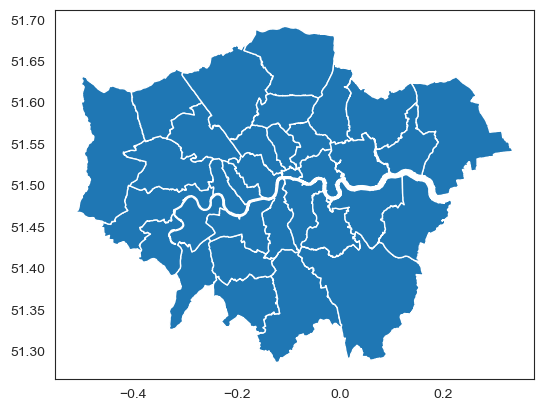

In [17]:
gdf.plot()

## Number of listings by neighborhood

Text(0.5, 1.0, 'Number of listings by neighbourhood')

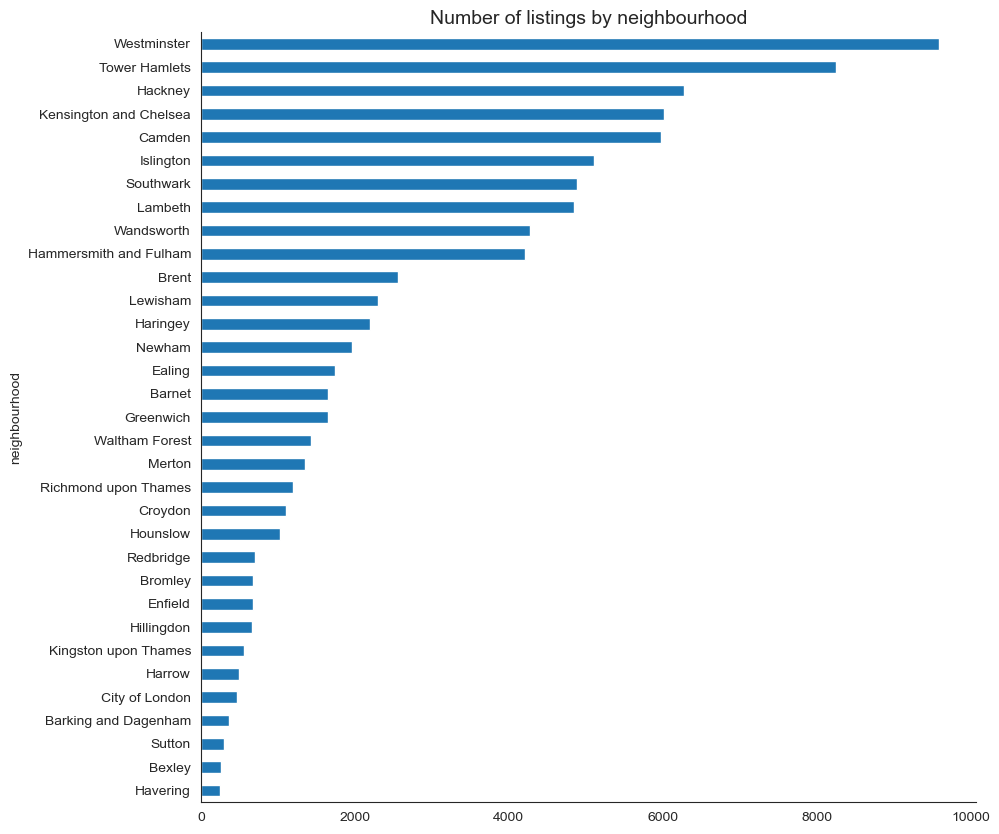

In [18]:
listings_df['neighbourhood'].value_counts().sort_values().plot.barh(figsize=(10, 10));
sns.despine()
plt.title('Number of listings by neighbourhood', fontsize=14)

## Number of listings by room type

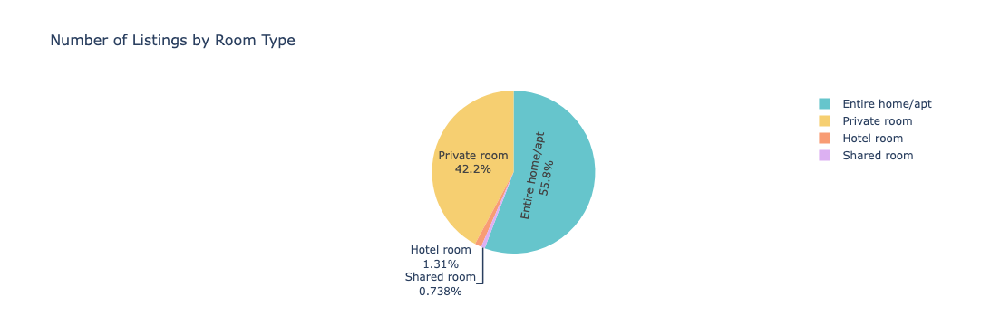

In [19]:
import plotly.express as px

room_type_counts = listings_df['room_type'].value_counts(dropna=False).reset_index()
room_type_counts.columns = ['room_type', 'count']

# Create the Plotly pie chart
fig = px.pie(
    room_type_counts,
    names="room_type",
    values="count",
    title="Number of Listings by Room Type",
    color="room_type",
    color_discrete_sequence=px.colors.qualitative.Pastel
)

# Update layout for better presentation
fig.update_traces(hoverinfo="label+percent+value", textinfo="percent+label")
fig.update_layout(title_font_size=16)

# Show the chart
fig.show()

## Country code distribution

In [20]:
print(listings_detail_df['country_code'].value_counts())
listings_detail_df.query('country_code != "GB"')

country_code
GB    85065
FR        2
ES        1
Name: count, dtype: int64


,id,listing_url,scrape_id,last_scraped,name,summary,space,description,experiences_offered,neighborhood_overview,...,instant_bookable,is_business_travel_ready,cancellation_policy,require_guest_profile_picture,require_guest_phone_verification,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
41783,23325697,https://www.airbnb.com/rooms/23325697,20191105115249,2019-11-06,Can torres,M7 minutes to Ibiza Town,NaN,M7 minutes to Ibiza Town,none,NaN,...,t,f,flexible,f,f,1,1,0,0,NaN
57006,30320965,https://www.airbnb.com/rooms/30320965,20191105115249,2019-11-05,"Chambre idéal pour couple, 10min à pied de Camden",Chambre lumineuse très bien situé à 7min à pie...,L’appartement est calme et très bien situé pou...,Chambre lumineuse très bien situé à 7min à pie...,none,Vous trouverez une station de métro (Kentish T...,...,f,f,flexible,f,f,1,0,1,0,0.1
61178,32394504,https://www.airbnb.com/rooms/32394504,20191105115249,2019-11-06,"Cosy one bedroom , near station Edgware",NaN,NaN,NaN,none,NaN,...,f,f,flexible,f,f,2,1,1,0,NaN


# Vizualizing which neighbourhood is preferable for renting based on guest review scores

## Integrate data

In [21]:
review_cols = ['review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
               'review_scores_communication', 'review_scores_location', 'review_scores_value']
host_cols = ['host_since', 'host_response_time',
             'host_is_superhost', 'host_has_profile_pic', 'host_identity_verified']

listing_detail_cols = ['id', 'instant_bookable', 'neighbourhood_cleansed', 'room_type'] + review_cols + host_cols 


res_listings_detail_df = listings_detail_df.query('country_code == "GB"')
res_listings_detail_df = res_listings_detail_df[res_listings_detail_df['host_name'].notnull()]
res_listings_detail_df = res_listings_detail_df[res_listings_detail_df.filter(regex='review_scores').notnull().all(axis=1)]
res_listings_detail_df = res_listings_detail_df[listing_detail_cols].rename({'neighbourhood_cleansed': 'neighbourhood'}, axis=1)
res_listings_detail_df.head()

,id,instant_bookable,neighbourhood,room_type,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,host_since,host_response_time,host_is_superhost,host_has_profile_pic,host_identity_verified
0,11551,t,Lambeth,Entire home/apt,9.0,9.0,10.0,10.0,9.0,9.0,2009-10-03,within an hour,t,t,t
2,13913,f,Islington,Private room,10.0,10.0,10.0,10.0,9.0,9.0,2009-11-16,within a few hours,f,t,f
3,38407,t,Tower Hamlets,Entire home/apt,9.0,10.0,10.0,10.0,9.0,9.0,2010-07-12,a few days or more,f,t,f
4,90700,t,Kensington and Chelsea,Entire home/apt,9.0,9.0,10.0,10.0,10.0,9.0,2011-04-07,within a day,f,t,f
5,15400,t,Kensington and Chelsea,Entire home/apt,10.0,10.0,10.0,10.0,10.0,9.0,2009-12-05,NaN,f,t,t


In [22]:
binary_cols = ['instant_bookable', 'host_is_superhost', 'host_has_profile_pic', 'host_identity_verified']
binary_map = {'f': False, 't': True}
res_listings_detail_df[binary_cols] = res_listings_detail_df[binary_cols].apply(lambda x: x.map(binary_map)).astype(bool)

cat_type = pd.api.types.CategoricalDtype(['not specified', 'within an hour', 'within a few hours', 'within a day', 'a few days or more'])
res_listings_detail_df['host_response_time'] = res_listings_detail_df['host_response_time'].fillna('not specified').astype(cat_type)

In [23]:
geo_cols = ['neighbourhood', 'geometry']
res_gdf = gdf.loc[:, geo_cols]
res_gdf.head()

,neighbourhood,geometry
0,Kingston upon Thames,"MULTIPOLYGON (((-0.33068 51.32901, -0.33059 51..."
1,Croydon,"MULTIPOLYGON (((-0.06402 51.31864, -0.06408 51..."
2,Bromley,"MULTIPOLYGON (((0.01213 51.2996, 0.01196 51.29..."
3,Hounslow,"MULTIPOLYGON (((-0.24456 51.4887, -0.24468 51...."
4,Ealing,"MULTIPOLYGON (((-0.41183 51.53408, -0.41188 51..."


In [24]:
res_gdf['area_sq_km'] = (res_gdf['geometry'].to_crs({'init': 'epsg:3395'})
                                    .map(lambda p: p.area / 10**6))

res_listings_detail_df['age'] = (pd.Timestamp('now') - pd.to_datetime(res_listings_detail_df['host_since'])).dt.days.div(365.25).round(2)

In [25]:
geo_listings_df = res_gdf.merge(res_listings_detail_df, how='inner', on='neighbourhood')

geo_listings_df['listings_count'] = geo_listings_df.groupby('neighbourhood')['id'].transform('count')
geo_listings_df['listings_density'] = geo_listings_df.groupby('neighbourhood')['area_sq_km'].transform(lambda x: len(x) / x)

geo_listings_df['mean_review_scores_accuracy'] = geo_listings_df.groupby('neighbourhood')['review_scores_accuracy'].transform('mean')
geo_listings_df['mean_review_scores_cleanliness'] = geo_listings_df.groupby('neighbourhood')['review_scores_cleanliness'].transform('mean')
geo_listings_df['mean_review_scores_checkin'] = geo_listings_df.groupby('neighbourhood')['review_scores_checkin'].transform('mean')
geo_listings_df['mean_review_scores_communication'] = geo_listings_df.groupby('neighbourhood')['review_scores_communication'].transform('mean')
geo_listings_df['mean_review_scores_location'] = geo_listings_df.groupby('neighbourhood')['review_scores_location'].transform('mean')
geo_listings_df['mean_review_scores_value'] = geo_listings_df.groupby('neighbourhood')['review_scores_value'].transform('mean')

geo_listings_df['mean_review_scores_all'] = geo_listings_df.filter(like='mean_review_scores').mean(axis=1)

In [26]:
def prepare_data(geo_listings_df):
    # Define review columns
    review_cols = ['review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                   'review_scores_communication', 'review_scores_location', 'review_scores_value']
    
    gdf = gpd.GeoDataFrame(geo_listings_df, geometry='geometry', crs='EPSG:4326')
    
    # Calculate mean scores by neighborhood
    scores = gdf.groupby('neighbourhood')[review_cols].mean().round(2)
    
    # Merge with geometry
    result = gdf[['neighbourhood', 'geometry']].drop_duplicates().merge(scores, on='neighbourhood')
    
    # Convert to GeoJSON format
    geojson_data = json.loads(result.to_json())
    
    return geojson_data

def create_choropleth(data, metric, title):
    return alt.Chart(
        alt.Data(values=data['features'])
    ).mark_geoshape(
        stroke='white',
        strokeWidth=0.5
    ).encode(
        color=alt.Color(
            f'properties.{metric}:Q',
            scale=alt.Scale(domain=[9.0, 9.8], scheme='viridis'),
            legend=alt.Legend(orient='top', title=None)
        ),
        tooltip=[
            alt.Tooltip(f'properties.neighbourhood:N', title='Neighbourhood'),
            alt.Tooltip(f'properties.{metric}:Q', title='Score', format='.2f')
        ]
    ).properties(
        width=300,
        height=300,
        title=title
    )

def create_visualization(geo_listings_df):
    # Prepare data
    geojson_data = prepare_data(geo_listings_df)
    
    # Define metrics and titles
    metrics = {
        'review_scores_accuracy': 'Accuracy',
        'review_scores_cleanliness': 'Cleanliness',
        'review_scores_checkin': 'Check-in',
        'review_scores_communication': 'Communication',
        'review_scores_location': 'Location',
        'review_scores_value': 'Value'
    }
    
    # Create charts
    charts = []
    for metric, title in metrics.items():
        chart = create_choropleth(geojson_data, metric, title)
        charts.append(chart)
    
    # Combine charts
    final_viz = alt.vconcat(
        alt.hconcat(*charts[:3]),
        alt.hconcat(*charts[3:])
    ).properties(
        title=alt.Title(
            'Average review scores by neighbourhood',
            fontSize=20
        )
    ).configure_view(
        strokeWidth=0
    )
    
    return final_viz

chart = create_visualization(geo_listings_df)

In [27]:
chart

alt.VConcatChart(...)

# Overall Review Score accross all types of review scores by Neighborhood

In [28]:
def prepare_data_overall(geo_listings_df):
    # Define review columns
    review_cols = ['review_scores_accuracy', 'review_scores_cleanliness', 'review_scores_checkin',
                   'review_scores_communication', 'review_scores_location', 'review_scores_value']
    
    gdf = gpd.GeoDataFrame(geo_listings_df, geometry='geometry', crs='EPSG:4326')
    
    # Calculate mean of all review scores for each neighborhood
    scores = gdf[review_cols].mean(axis=1)
    gdf['overall_score'] = scores
    
    # Calculate mean overall score by neighborhood
    neighborhood_scores = gdf.groupby('neighbourhood')['overall_score'].mean().round(2)
    
    # Merge with geometry
    result = gdf[['neighbourhood', 'geometry']].drop_duplicates().merge(
        neighborhood_scores.reset_index(), 
        on='neighbourhood'
    )
    
    # Convert to GeoJSON format
    geojson_data = json.loads(result.to_json())
    
    return geojson_data

def create_overall_choropleth(data):
    return alt.Chart(
        alt.Data(values=data['features'])
    ).mark_geoshape(
        stroke='white',
        strokeWidth=0.5
    ).encode(
        color=alt.Color(
            'properties.overall_score:Q',
            scale=alt.Scale(domain=[9.0, 9.8], scheme='viridis'),
            legend=alt.Legend(orient='top', title='Average Score')
        ),
        tooltip=[
            alt.Tooltip('properties.neighbourhood:N', title='Neighbourhood'),
            alt.Tooltip('properties.overall_score:Q', title='Overall Score', format='.2f')
        ]
    ).properties(
        width=600,
        height=600,
        title=alt.Title(
            'Overall Review Score by Neighborhood',
            fontSize=20,
            anchor='middle'
        )
    ).configure_view(
        strokeWidth=0
    )

# Create and display the visualization
geojson_data = prepare_data_overall(geo_listings_df)
overall_chart = create_overall_choropleth(geojson_data)
overall_chart

alt.Chart(...)

# Visualizing price per night for all Neighbourhoods based on the Room type using a box-plot

In [29]:
listings_df.price.describe()

count    85068.000000
mean       122.336766
std        220.749123
min          0.000000
25%         47.000000
50%         84.000000
75%        140.000000
max      12345.000000
Name: price, dtype: float64

In [30]:
listings_df.neighbourhood.unique()

array(['Lambeth', 'Islington', 'Kensington and Chelsea', 'Westminster',
       'Wandsworth', 'Croydon', 'Tower Hamlets', 'Hammersmith and Fulham',
       'Barnet', 'Merton', 'Hounslow', 'Camden', 'Haringey',
       'Richmond upon Thames', 'Southwark', 'Hackney', 'Brent', 'Ealing',
       'Waltham Forest', 'Newham', 'Lewisham', 'Enfield',
       'City of London', 'Greenwich', 'Bromley', 'Hillingdon', 'Havering',
       'Barking and Dagenham', 'Harrow', 'Redbridge',
       'Kingston upon Thames', 'Bexley', 'Sutton'], dtype=object)

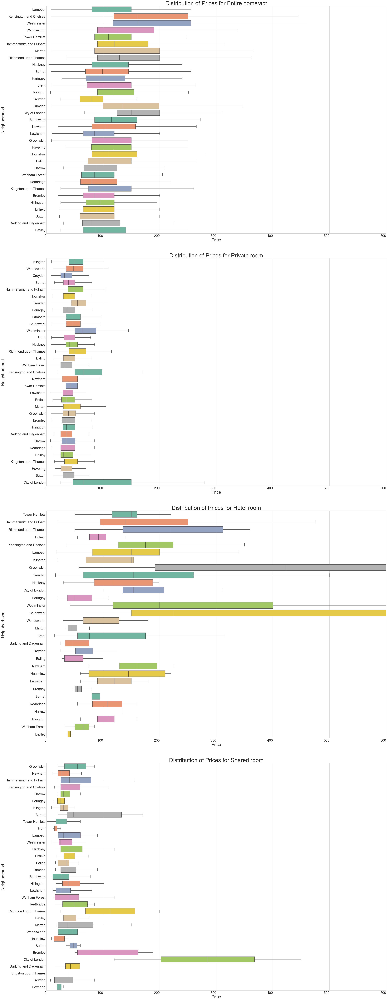

In [31]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Convert price to numeric, removing any non-numeric characters (like '$')
listings_df['price'] = pd.to_numeric(listings_df['price'].replace('[\$,]', '', regex=True), errors='coerce')

listings_filtered = listings_df[(listings_df['price'] >= 0)]

# List of room types
room_types = listings_filtered['room_type'].unique()

# Set the style and figure size 
sns.set_style("whitegrid")
plt.figure(figsize=(40, 100)) 

# Plot a separate box plot for each room type
for i, room_type in enumerate(room_types):
    plt.subplot(len(room_types), 1, i+1)  # Create subplots stacked vertically
    
    # Filter data for the room type
    room_type_data = listings_filtered[listings_filtered['room_type'] == room_type]
    
    # Create the boxplot for the filtered data
    sns.boxplot(
        data=room_type_data,
        y='neighbourhood',
        x='price',
        showfliers=False,  
        palette='Set2'  
    )

    plt.xticks(ha='right', fontsize=24)
    plt.yticks(fontsize=24)

    # Set labels and title
    plt.xlabel('Price', fontsize=30)
    plt.ylabel('Neighborhood', fontsize=30)
    plt.title(f'Distribution of Prices for {room_type}', fontsize=40)

    plt.xlim(0, 600)

plt.tight_layout(pad=8.0) 

plt.show()

# Visualizing portions of Listings by Room  for all Neighbourhoods using a treemap

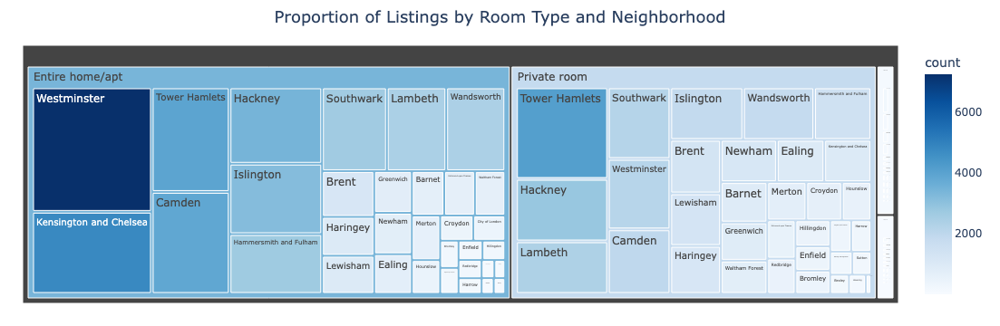

In [32]:
# Aggregate data for the treemap
treemap_data = listings_df.groupby(['room_type', 'neighbourhood']).size().reset_index(name='count')

# Create the treemap
fig = px.treemap(
    treemap_data,
    path=['room_type', 'neighbourhood'],  
    values='count',  
    title='Proportion of Listings by Room Type and Neighborhood',
    color='count',  
    color_continuous_scale='Blues', 
    labels={'room_type': 'Room Type', 'neighbourhood': 'Neighborhood'}
)

fig.update_layout(
    title_font_size=18,
    title_x=0.5,
    margin=dict(t=50, l=25, r=25, b=25)
)

fig.show()

# Interactive Visualization of listings accross all neighborhoods 

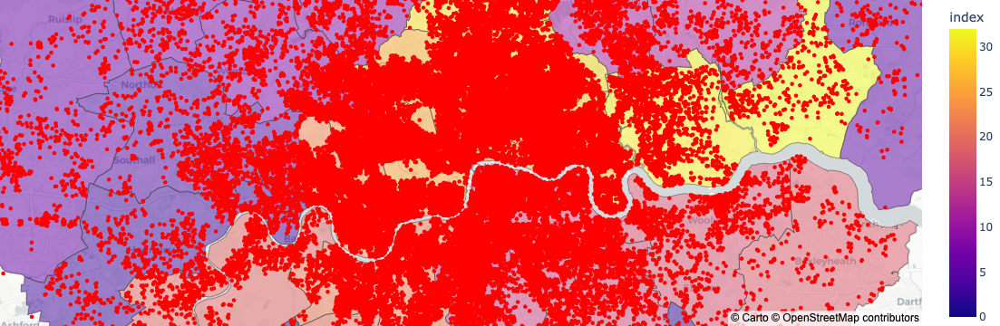

In [33]:
# Create a GeoDataFrame from the listings data
listings_gdf = gpd.GeoDataFrame(
    listings_detail_df, 
    geometry=gpd.points_from_xy(listings_detail_df.longitude, listings_detail_df.latitude),
    crs="EPSG:4326"
)

# Perform a spatial join to determine which neighborhood each listing belongs to
listings_with_neighborhoods = gpd.sjoin(listings_gdf, gdf, how="left", predicate="within")

# Create the hover text
hover_text = (
    "Name: " + listings_with_neighborhoods['name'].fillna('No name').astype(str) + 
    "<br>Review Score: " + listings_with_neighborhoods['review_scores_rating'].fillna('No rating').astype(str) +
    "<br>Neighbourhood: " + listings_with_neighborhoods['neighbourhood_left'].fillna('Unknown').astype(str)
)

# Create the interactive map
fig = px.choropleth_mapbox(gdf,
                           geojson=gdf.geometry,
                           locations=gdf.index,
                           color=gdf.index,
                           hover_name=gdf.index,
                           mapbox_style="carto-positron",
                           center={"lat": listings_detail_df.latitude.mean(), "lon": listings_detail_df.longitude.mean()},
                           zoom=10,
                           opacity=0.5)

# Add scatter plot for listings
fig.add_scattermapbox(lat=listings_with_neighborhoods.latitude,
                      lon=listings_with_neighborhoods.longitude,
                      mode='markers',
                      marker=dict(size=5, color='red'),
                      text=hover_text,
                      hoverinfo='text')

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()